# Single Cell RNA Sequencing Analysis
### Author: Sofia Monsalve r0870275

# Introduction to the biological system

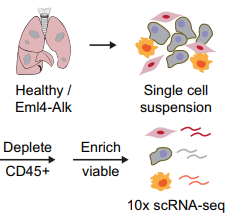

The goal of this analysis is to perform a scRNA-seq pipeline between two different conditions: Healthy lung cells and Eml4-Alk mutant cells with NSCLC (Non-small-cell lung cancer) in mice. The Eml4-Alk mutation results as a fusion between a portion of the EML4 gene with the ALK gene, which leads to an abnormal protein that drives cancer growth, in this specific case lung cancer. 

Single cell suspensions were prepared from excised lungs of Eml4-Alk and wild type C57/Bl6J mice [1]. Suspensions were pooled from n=3 mice per condition, and then were enriched for cell viability and depleted for CD45+ cells to remove inmune cells from the mixture[1]. The experimental flow can be seen in the figure above.

Single cells were processed using the 10X Genomics Single Cell 3’ platform using the Chromium Single Cell 3’ Library & Gel Bead Kit V2 kit (10X Genomics). The libraries were sequenced using an Illumina NovaSeq6000 sequencer on an Illumina NovaSeq SP flow cell [1].


## Data set description

The data used here can be accessed here: https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE191078

It consists of two count matrices:
-  Wild Type lung cells
-  Eml4-Alk lung cells

### 1. Read the Count matrices

The coun matrices were downloaded from the link above into the corresponding jupyter folder. Using scanpy package in python both data sets were save as AnnData objects.
- Wild Type: adata1, it contains 15867 cells and 32285 genes.
- Eml4-Alk: adata2, it contains 21856 cells and 32285 genes. 

In [36]:
import scanpy as sc
import numpy as np

In [37]:
file_path = "/mnt/storage/r0870275/jupyternotebooks/scRNA_seq_assign/GSM5738369_WT_filtered_feature_bc_matrix.h5"
file_path2 = "/mnt/storage/r0870275/jupyternotebooks/scRNA_seq_assign/GSM5738370_EA_filtered_feature_bc_matrix.h5"

In [38]:
adata1 = sc.read_10x_h5(file_path)
adata2 = sc.read_10x_h5(file_path2)

/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [39]:
adata1


AnnData object with n_obs × n_vars = 15867 × 32285
    var: 'gene_ids', 'feature_types', 'genome'

In [40]:
adata1.X
adata1.X.todense()

matrix([[0., 0., 0., ..., 0., 0., 2.],
        [0., 0., 0., ..., 0., 0., 1.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 2.],
        [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

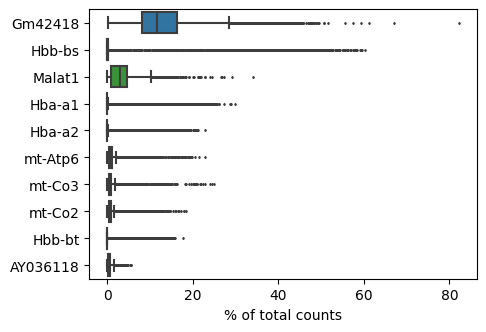

In [41]:
sc.pl.highest_expr_genes(adata1, n_top=10)

For the WT data set: This graph shows that some of the most expressed genes are mitochondrial genes, this has to be filteres.

In [42]:
adata2

AnnData object with n_obs × n_vars = 21856 × 32285
    var: 'gene_ids', 'feature_types', 'genome'

In [43]:
adata2.X
adata2.X.todense()

matrix([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

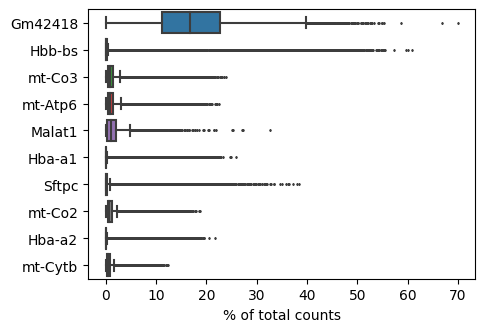

In [44]:
sc.pl.highest_expr_genes(adata2, n_top=10)

For the Eml4-Alk mutant data set: This graph shows that some of the most expressed genes are mitochondrial genes, this has to be filteres.

In [45]:
adata1.obs['sample_id'] = 'WT'
adata1.obs['library_id'] = 'WT_raw'

adata2.obs['sample_id'] = 'EA'
adata2.obs['library_id'] = 'EA_raw'

In [46]:
adata1.var_names_make_unique()
adata2.var_names_make_unique()

### 2. Quality Control

### 2.1 Doublets

To filter doublet cells in the count matrices, Scrublet was used. With a expected doublet rate of 0.07. The predicted score of doublet is going to be save in the data objects so it can be filter further ahead in the analysis.

In [47]:
%matplotlib inline
import scrublet as scr

In [48]:
scrub = scr.Scrublet(adata1.X, expected_doublet_rate=0.07)
# expected_doublet_rate according to genomic10x

In [49]:
doublet_scores, predicted_doublets = scrub.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.31
Detected doublet rate = 2.0%
Estimated detectable doublet fraction = 16.1%
Overall doublet rate:
	Expected   = 7.0%
	Estimated  = 12.7%
Elapsed time: 37.7 seconds


(<Figure size 800x300 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

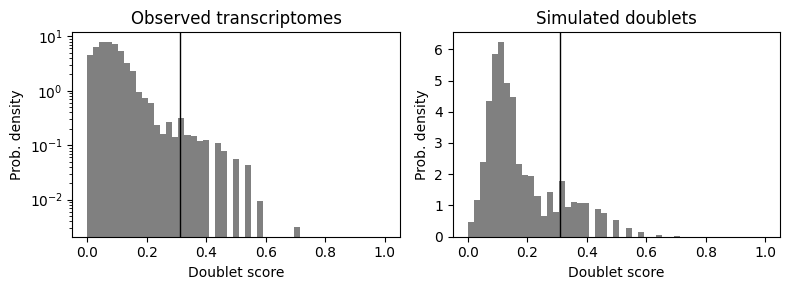

In [50]:
scrub.plot_histogram()

In [51]:
adata1.obs['predicted_doublets'] = predicted_doublets.copy()
adata1.obs['doublet_scores'] = doublet_scores.copy()

In [52]:
scrub = scr.Scrublet(adata2.X, expected_doublet_rate=0.07)

In [53]:
doublet_scores, predicted_doublets = scrub.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.23
Detected doublet rate = 3.0%
Estimated detectable doublet fraction = 17.9%
Overall doublet rate:
	Expected   = 7.0%
	Estimated  = 16.7%
Elapsed time: 118.5 seconds


(<Figure size 800x300 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

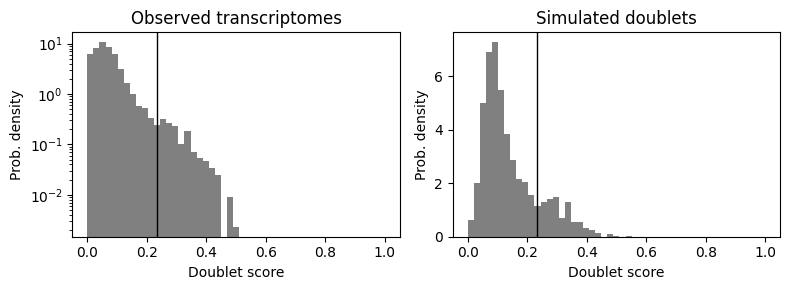

In [54]:
scrub.plot_histogram()

In [55]:
adata2.obs['predicted_doublets'] = predicted_doublets.copy()
adata2.obs['doublet_scores'] = doublet_scores.copy()

### 2.2 QC Filtering

Some initial filtering based on count has to be performed for both datasets. This is done to remove barcodes that correspondto broken or no cells. The threshold here is 200 genes with a minimum of 3 cells.

- Wild Type: adata1, after filtering contains 14817 cells and 17425 genes.
- Eml4-Alk: adata2, after filtering 20055 cells and 18891 genes.

In [56]:
sc.pp.filter_cells(adata1, min_genes=200)
sc.pp.filter_genes(adata1, min_cells=3)

sc.pp.filter_cells(adata2, min_genes=200)
sc.pp.filter_genes(adata2, min_cells=3)

In [57]:
adata1

AnnData object with n_obs × n_vars = 14817 × 17425
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'

In [58]:
adata2

AnnData object with n_obs × n_vars = 20055 × 18891
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'

### 3. Combining both datasets into one data object

Both data sets were combined into one using the concatenate function in python. A sample id column was added to differentiate between WT and EA.

In [59]:
# combine anndata
adata = adata1.concatenate(adata2, batch_key='sample_id', uns_merge='unique', join='outer',
                           batch_categories=['WT', 'EA'], index_unique="___")

/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [60]:
adata

AnnData object with n_obs × n_vars = 34872 × 19406
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes'
    var: 'gene_ids-EA', 'feature_types-EA', 'genome-EA', 'n_cells-EA', 'gene_ids-WT', 'feature_types-WT', 'genome-WT', 'n_cells-WT'

In [61]:
adata.X
adata.X.todense()

matrix([[ 0.,  0.,  0., ...,  1.,  0.,  0.],
        [ 0.,  0.,  0., ...,  5.,  2.,  0.],
        [ 0.,  0.,  0., ...,  0.,  1.,  0.],
        ...,
        [ 0.,  0.,  0., ...,  2., 13.,  1.],
        [ 0.,  0.,  0., ...,  0.,  1.,  0.],
        [ 0.,  0.,  0., ...,  6.,  2.,  0.]], dtype=float32)

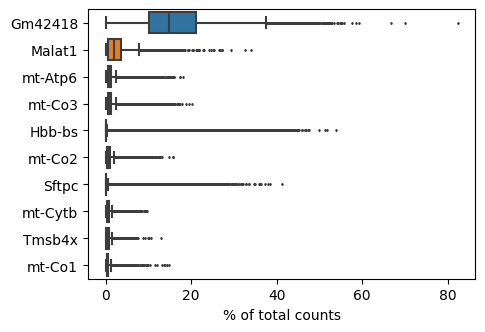

In [62]:
sc.pl.highest_expr_genes(adata, n_top=10)

In [63]:
adata.obs

,sample_id,library_id,predicted_doublets,doublet_scores,n_genes
AAACCCAAGAGGTATT-1___WT,WT,WT_raw,False,0.095946,858
AAACCCAAGGTGCTGA-1___WT,WT,WT_raw,False,0.157537,1935
AAACCCACACCTATCC-1___WT,WT,WT_raw,False,0.028697,371
AAACCCACAGCATACT-1___WT,WT,WT_raw,False,0.044828,445
AAACCCACAGTTCCAA-1___WT,WT,WT_raw,False,0.083179,665
...,...,...,...,...,...
TTTGTTGTCCACTTTA-1___EA,EA,EA_raw,False,0.044586,1173
TTTGTTGTCCGTATAG-1___EA,EA,EA_raw,False,0.118483,2482
TTTGTTGTCCTCAGGG-1___EA,EA,EA_raw,False,0.222758,2097
TTTGTTGTCTCAAAGC-1___EA,EA,EA_raw,False,0.019710,1153


### 3.1 QC distributions

For each sample the distributions of gene counts, total counts and mitochondrial counts is compared.

In [64]:
adata.var['mt'] = adata.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

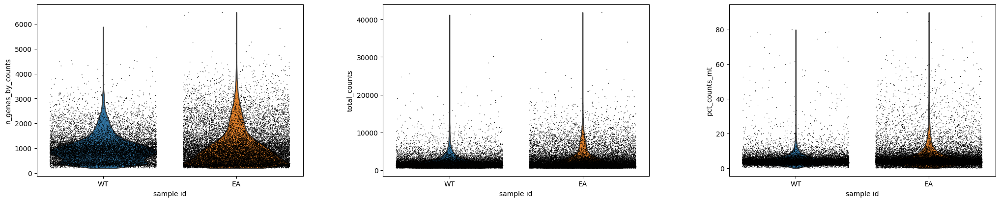

In [65]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, groupby='sample_id')

Here, we can see that the distributions are different but not so greatly. A threshold of 4000 genes was set for the WT data and 3000 for the EA data. total counts greater than 1000 were filter for the EA set. Finally, in boths sets mitochondrial genes were filtered.
Furthermore, both datasets were additionally filtered to remove cells expressing Ptprc (CD45) given thatthiscould include inmune cells.

In [66]:
adata1.var['mt'] = adata1.var_names.str.startswith('mt-')
adata2.var['mt'] = adata2.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(adata1, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pp.calculate_qc_metrics(adata2, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [67]:
adata1 = adata1[adata1.obs.n_genes_by_counts < 4000, :]
adata2 = adata2[adata2.obs.n_genes_by_counts < 3000, :]

adata2 = adata2[adata2.obs.total_counts < 10000, :]

adata1 = adata1[adata1.obs.pct_counts_mt < 5, :]
adata2 = adata2[adata2.obs.pct_counts_mt < 5, :]

In [68]:
adata1

View of AnnData object with n_obs × n_vars = 10259 × 17425
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [69]:
adata2

View of AnnData object with n_obs × n_vars = 11273 × 18891
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [70]:
p=adata2.var_names.str.startswith('Ptprcap')
row_index = adata2.var_names.get_loc('Ptprcap')
columns_to_remove = adata2.X[:, row_index] == 0
adata2 = adata2[columns_to_remove,:]
adata2

/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3378: SparseEfficiencyWarning: Comparing a sparse matrix with 0 using == is inefficient, try using != instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


View of AnnData object with n_obs × n_vars = 10872 × 18891
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [71]:
p=adata1.var_names.str.startswith('Ptprcap')
row_index = adata1.var_names.get_loc('Ptprcap')
columns_to_remove = adata1.X[:, row_index] == 0
adata1 = adata1[columns_to_remove,:]
adata1

View of AnnData object with n_obs × n_vars = 10255 × 17425
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

### 3.2 Combining the data again

In [217]:
# combine anndata
adata = adata1.concatenate( adata2, batch_key="sample_id", uns_merge="unique", 
                           batch_categories=['WT', 'EA'], index_unique="___")
adata

/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 21127 × 16910
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells-EA', 'n_cells_by_counts-EA', 'mean_counts-EA', 'pct_dropout_by_counts-EA', 'total_counts-EA', 'n_cells-WT', 'n_cells_by_counts-WT', 'mean_counts-WT', 'pct_dropout_by_counts-WT', 'total_counts-WT'

### 3.3 Data Normalization and Embedding

The counts per cell are log normalized. this normalized data is stored in .raw

In [218]:
sc.pp.normalize_total(adata, target_sum=1e4)  #scaling factor is 10000

In [219]:
sc.pp.log1p(adata)

In [220]:
adata.raw = adata

### 3.4 PCA

Data was scale before perfrming PCA.

In [221]:
sc.pp.highly_variable_genes(adata, flavor="seurat", n_top_genes=3000, inplace=True)

In [222]:
sc.pp.scale(adata, max_value=10)

In [223]:
sc.pp.pca(adata, n_comps=50, use_highly_variable=True)

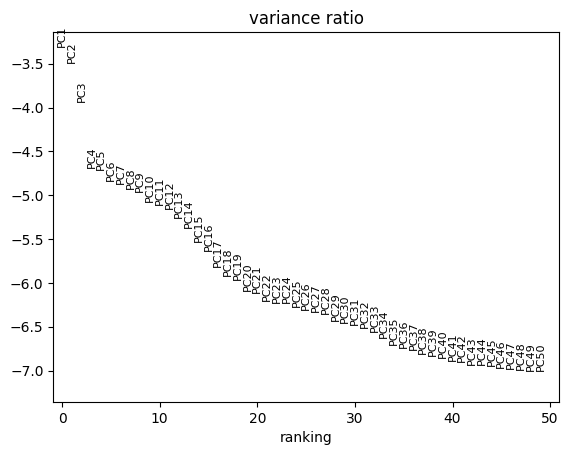

In [224]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=50)

#### UMAP

The UMAP is computed per sample. It is obvious that the data clusters per sample so this is a sign of batch effects. This can also be observed in the densities UMAP.

In [225]:
sc.pp.neighbors(adata, n_pcs=40, random_state=42)
sc.tl.umap(adata, random_state=42)

In [226]:
adata.obsm['X_umap_preharmony']  = adata.obsm['X_umap'].copy()

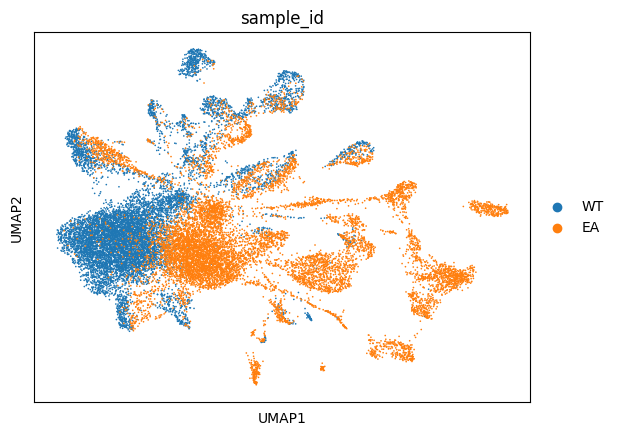

In [227]:
sc.pl.umap(adata, color="sample_id")

In [228]:
sc.tl.embedding_density(adata, basis='umap_preharmony', groupby='sample_id', key_added='density_X_umap_sample_id')

In [229]:
adata

AnnData object with n_obs × n_vars = 21127 × 16910
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'density_X_umap_sample_id'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells-EA', 'n_cells_by_counts-EA', 'mean_counts-EA', 'pct_dropout_by_counts-EA', 'total_counts-EA', 'n_cells-WT', 'n_cells_by_counts-WT', 'mean_counts-WT', 'pct_dropout_by_counts-WT', 'total_counts-WT', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'sample_id_colors', 'density_X_umap_sample_id_params'
    obsm: 'X_pca', 'X_umap', 'X_umap_preharmony'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

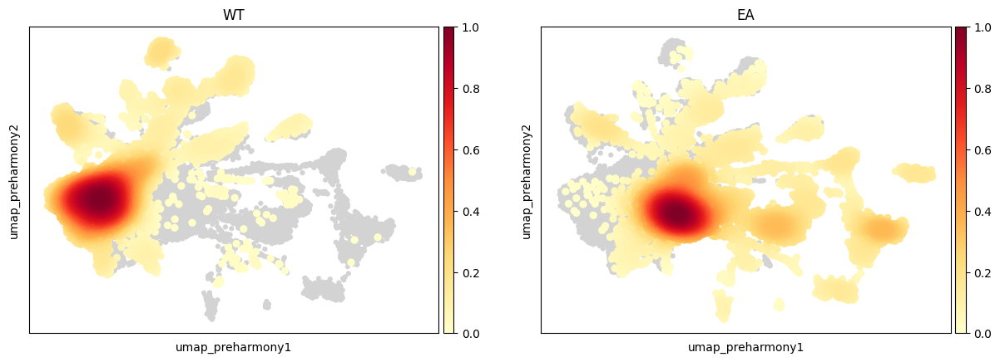

In [230]:
sc.pl.embedding_density(adata,  basis='umap_preharmony', key='density_X_umap_sample_id')

### Correcting batch effects

To correct for batch effects we used the Harmony method. After computing the PCA and plotting the UMAP, we can see that most of the clusters contain data from both samples.

In [231]:
# data integration with harmony
sc.external.pp.harmony_integrate(adata, 'sample_id', basis='X_pca', adjusted_basis='X_pca_harmony')

2023-12-06 23:41:11,361 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2023-12-06 23:41:18,054 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2023-12-06 23:41:24,589 - harmonypy - INFO - Iteration 3 of 10
INFO:harmonypy:Iteration 3 of 10
2023-12-06 23:41:31,234 - harmonypy - INFO - Iteration 4 of 10
INFO:harmonypy:Iteration 4 of 10
2023-12-06 23:41:38,245 - harmonypy - INFO - Iteration 5 of 10
INFO:harmonypy:Iteration 5 of 10
2023-12-06 23:41:43,351 - harmonypy - INFO - Iteration 6 of 10
INFO:harmonypy:Iteration 6 of 10
2023-12-06 23:41:47,021 - harmonypy - INFO - Iteration 7 of 10
INFO:harmonypy:Iteration 7 of 10
2023-12-06 23:41:50,226 - harmonypy - INFO - Converged after 7 iterations
INFO:harmonypy:Converged after 7 iterations


In [232]:
adata

AnnData object with n_obs × n_vars = 21127 × 16910
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'density_X_umap_sample_id'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells-EA', 'n_cells_by_counts-EA', 'mean_counts-EA', 'pct_dropout_by_counts-EA', 'total_counts-EA', 'n_cells-WT', 'n_cells_by_counts-WT', 'mean_counts-WT', 'pct_dropout_by_counts-WT', 'total_counts-WT', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'sample_id_colors', 'density_X_umap_sample_id_params'
    obsm: 'X_pca', 'X_umap', 'X_umap_preharmony', 'X_pca_harmony'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

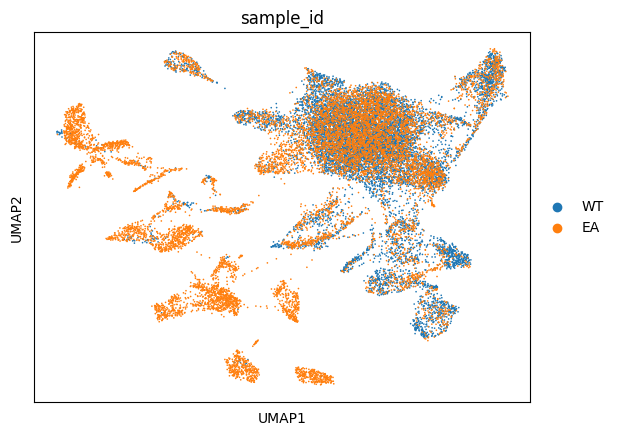

In [233]:
sc.pp.neighbors(adata, use_rep='X_pca_harmony', key_added='neighbors_harmony', n_pcs=40, random_state=42)
sc.tl.umap(adata, neighbors_key='neighbors_harmony', random_state=42)
sc.pl.umap(adata, color="sample_id")

In [234]:
adata.obsm['X_umap_harmony']  = adata.obsm['X_umap'].copy()

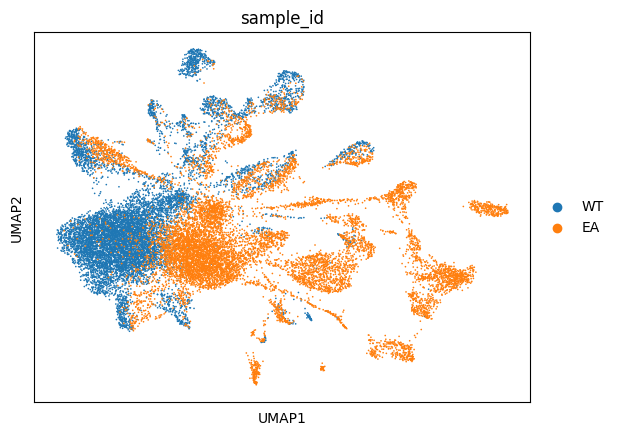

In [235]:
adata.obsm['X_umap'] = adata.obsm['X_umap_preharmony'].copy()
sc.pl.umap(adata, color="sample_id")

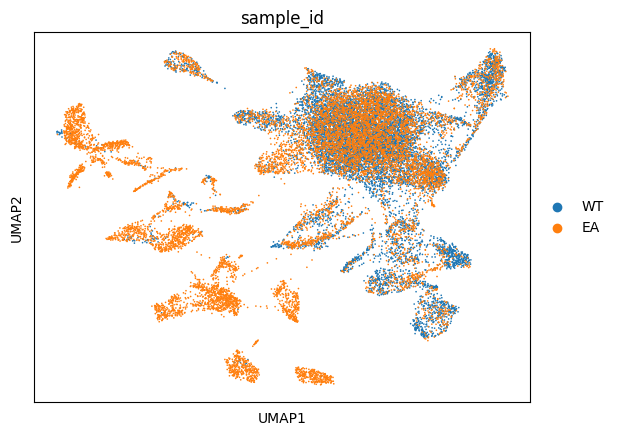

In [236]:
adata.obsm['X_umap'] = adata.obsm['X_umap_harmony'].copy()
sc.pl.umap(adata, color="sample_id")

In [237]:
sc.tl.embedding_density(adata, basis='umap_harmony', groupby='sample_id', 
                        key_added='density_X_umap_harmony_sample_id')

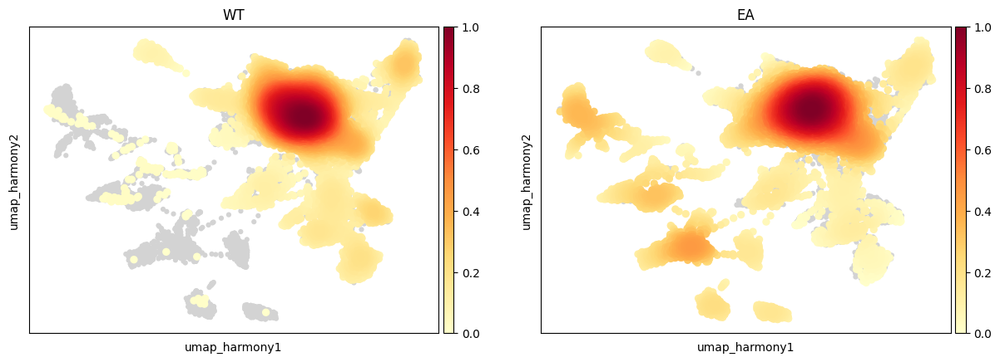

In [238]:
sc.pl.embedding_density(adata,  basis='umap_harmony', key='density_X_umap_harmony_sample_id')

In the densities UMAP we see that come clusters do not integrated well, specially in the WT samples (grey clusters). We can check if these correspond to doublets.

In [239]:
adata.obs['str_predicted_doublets'] = [str(dbl) for dbl in adata.obs['predicted_doublets']]

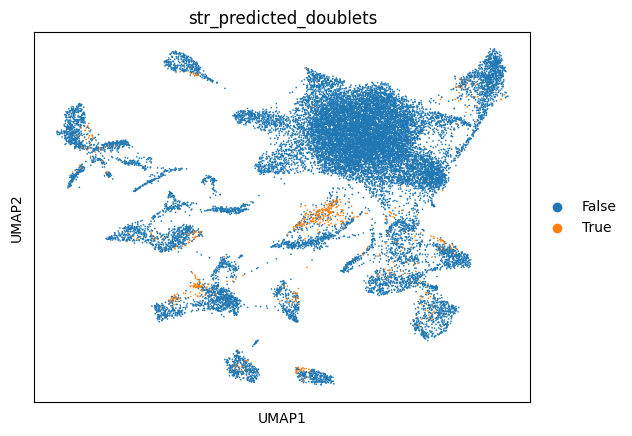

In [240]:
sc.pl.umap(adata, color=['str_predicted_doublets'])

In fact, we see that the doublets (orange points) are located in some of the clusters that did not integrated well. But the points are not a lot of them so they will be ignored.

Now data is integrated

In [241]:
adata

AnnData object with n_obs × n_vars = 21127 × 16910
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'density_X_umap_sample_id', 'density_X_umap_harmony_sample_id', 'str_predicted_doublets'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells-EA', 'n_cells_by_counts-EA', 'mean_counts-EA', 'pct_dropout_by_counts-EA', 'total_counts-EA', 'n_cells-WT', 'n_cells_by_counts-WT', 'mean_counts-WT', 'pct_dropout_by_counts-WT', 'total_counts-WT', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'sample_id_colors', 'density_X_umap_sample_id_params', 'neighbors_harmony', 'density_X_umap_harmony_sample_id_params', 'str_predicted_doublets_colors'
    obsm: 'X_pca', 'X_umap', 'X_umap_preharmony', 'X_pca_harmony', 'X_umap_harmony'
    varm: 'PCs'
    obsp: 'distances', 'connectivities', 'neighbors_harmony

In [242]:
adata.X.shape

(21127, 16910)

### 4. Variable Genes

In order to perform clustering we can compute the PCA again. The results will be genes which explain high variance among the single cell data.

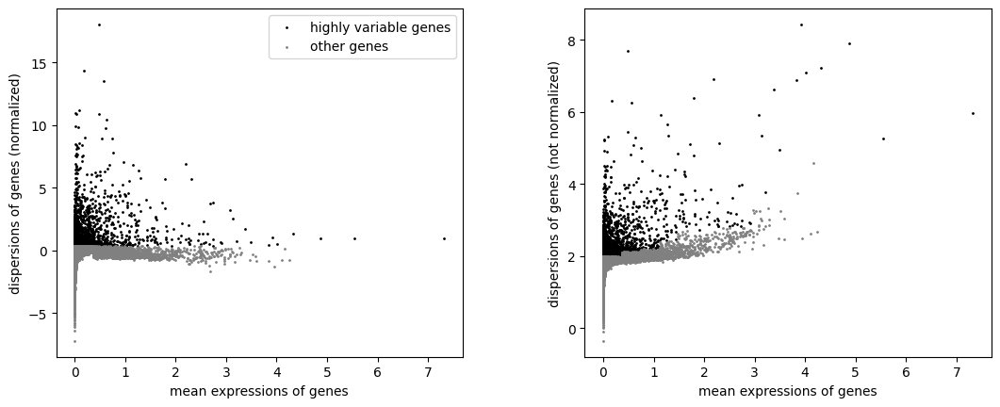

In [243]:
sc.pl.highly_variable_genes(adata)

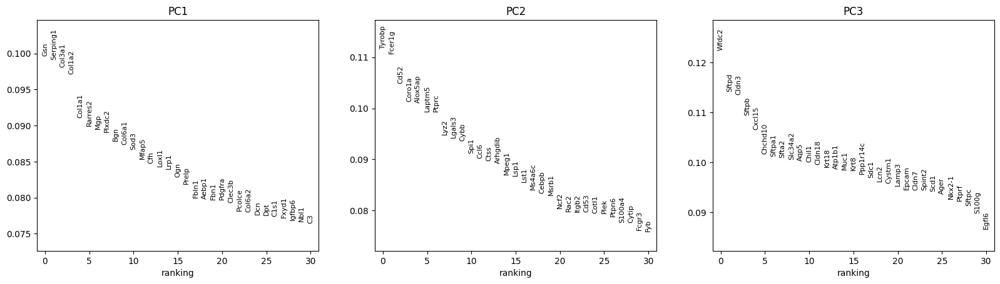

In [244]:
sc.pl.pca_loadings(adata, include_lowest=False)

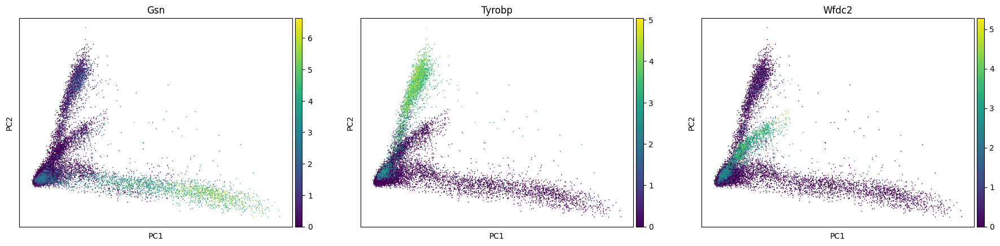

In [245]:
sc.pl.pca(adata, color=['Gsn', 'Tyrobp', 'Wfdc2'])

The number of PCA will be limited to 50 for the elbow graph.

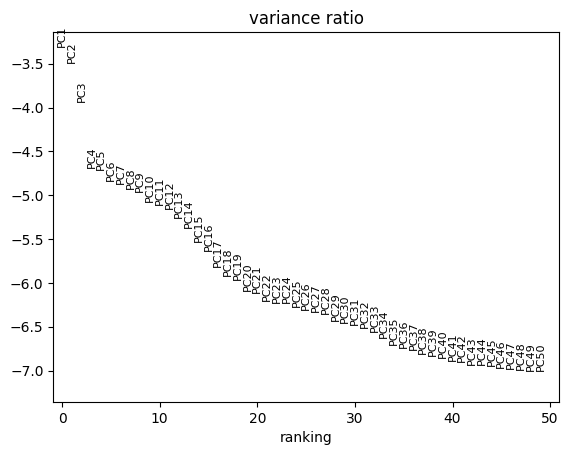

In [246]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=50)

From the elbow graph 40 components were selected.

### 4. Embeddings 

On the UMAP we can see that the genes with the highest loadings for the first 3 PCs are associated with distinct clusters. We can see that each of these genes correspond to a cluster.

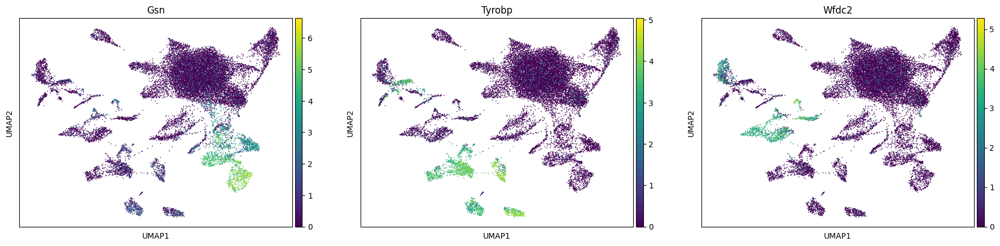

In [247]:
sc.pp.neighbors(adata, n_pcs=40)
sc.tl.umap(adata, neighbors_key='neighbors_harmony',random_state=42)
sc.pl.umap(adata,color=['Gsn', 'Tyrobp', 'Wfdc2']) #all each gene is associated with a different cluster

Alternatively, we can also compute a tSNE to visualize single cell data in 2D.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


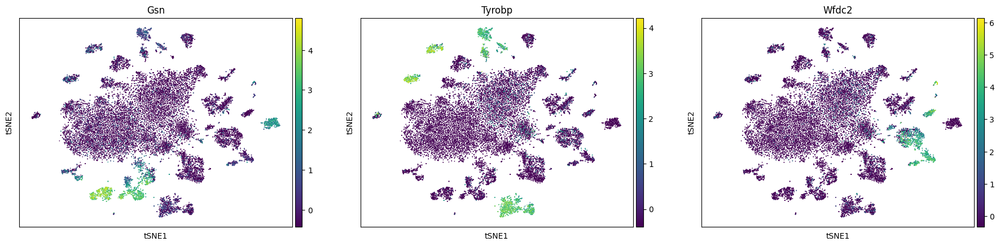

In [248]:
sc.tl.tsne(adata, n_pcs=40)
sc.pl.tsne(adata, color=['Gsn', 'Tyrobp', 'Wfdc2'], use_raw=False)

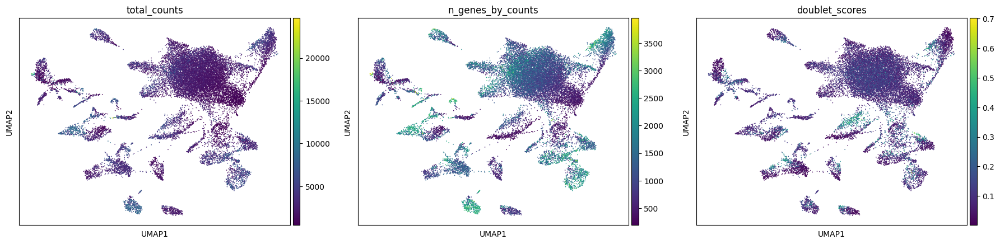

In [249]:
sc.pl.umap(adata, color=['total_counts', 'n_genes_by_counts', 'doublet_scores'], use_raw=False)

We can see in this UMAP that there is not a lot of biases in the total counts, gene counts and doublet scores in the data.

The coordinates of embeddings are stored in .obsm entries

In [250]:
adata.obsm

AxisArrays with keys: X_pca, X_umap, X_umap_preharmony, X_pca_harmony, X_umap_harmony, X_tsne

### 5. Clustering

Leiden clustering is computed to identify different cell types. Different resolutions will output different results. We tried here different resolution values.

In [251]:
sc.tl.leiden(adata,neighbors_key='neighbors_harmony',resolution=0.25)

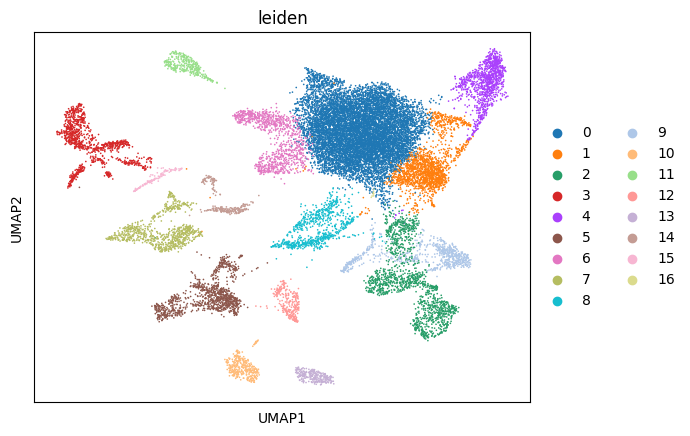

In [252]:
sc.pl.umap(adata,neighbors_key='neighbors_harmony',color=['leiden'])

In [253]:
resolutions = [0.1, 0.3, 0.6, 1, 1.5, 2, 2.5, 3]

for res in resolutions:
    sc.tl.leiden(adata, neighbors_key='neighbors_harmony',resolution=res, key_added='leiden_' + str(res) )

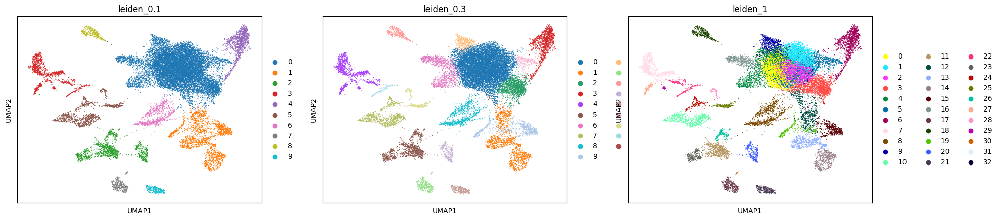

In [254]:
sc.pl.umap(adata, color=['leiden_0.1', 'leiden_0.3', 'leiden_1'])

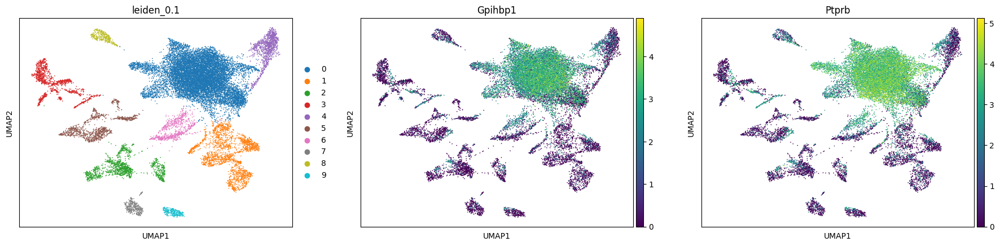

In [255]:
sc.pl.umap(adata, color=['leiden_0.1', 'Gpihbp1', 'Ptprb'])

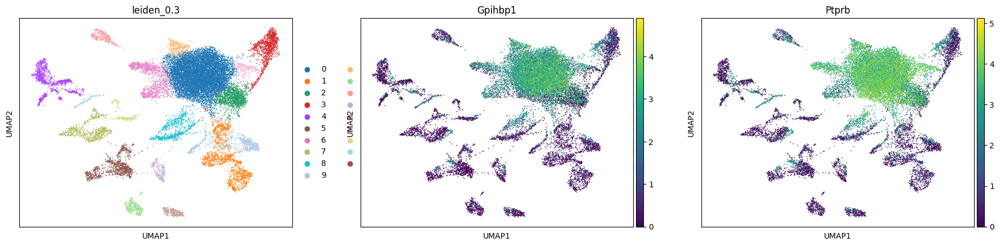

In [256]:
sc.pl.umap(adata, color=['leiden_0.3', 'Gpihbp1', 'Ptprb'])

A resolution of 0.1 will be used

### 5.1 Removing doublet clusters

We can remove clusters that have a high fraction of doublets. Our data does not contain a lot of doublets but we can filter them further.

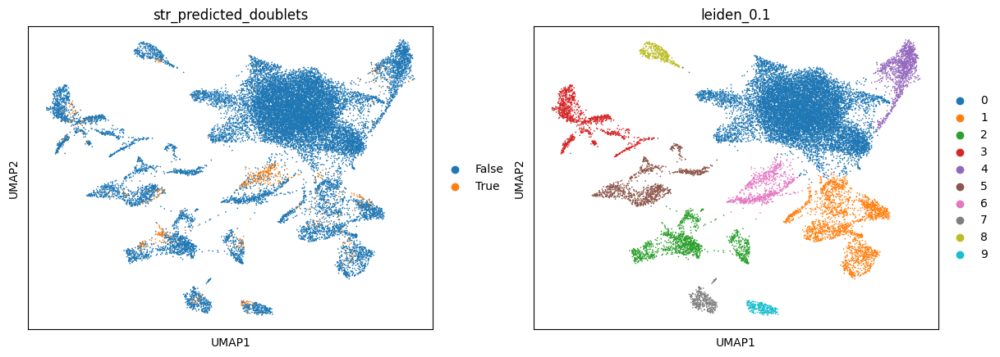

In [257]:
adata.obs['str_predicted_doublets'] = [str(dbl) for dbl in adata.obs['predicted_doublets']]
sc.pl.umap(adata, color=['str_predicted_doublets', 'leiden_0.1'])

We see that cluster 6 doublets. we can compute the fraction of doublets per cluster and filter them.

In [258]:
# what is fraction of doublets per cluster
import numpy as np
import pandas as pd

# init lists
list_clusters = np.unique(adata.obs['leiden_0.1'])
list_size = []
list_frac_doublets = []

# loop over clusters
for clus in list_clusters:
    clus_adata = adata[adata.obs['leiden_0.1'] == clus]
    
    size = clus_adata.shape[0]
    n_doublets = sum( clus_adata.obs['predicted_doublets'])
    
    list_frac_doublets.append( n_doublets / size )
    list_size.append(size)
    
df_frac_doublets = pd.DataFrame(
{
    'cluster': list_clusters,
    'size': list_size,
    'frac_doublets': list_frac_doublets
}
)

In [259]:
df_frac_doublets.sort_values('frac_doublets', ascending=False)
# Not necesary to filter doublets

,cluster,size,frac_doublets
6,6,743,0.288022
9,9,270,0.114815
2,2,1337,0.098728
1,1,2159,0.054192
7,7,361,0.049861
3,3,1217,0.046015
8,8,328,0.045732
5,5,1074,0.043762
4,4,1127,0.038154
0,0,12511,0.002078


In [260]:
doublet_clusters = [ clus for clus 
                    in df_frac_doublets[ df_frac_doublets['frac_doublets'] >= 0.1 ]['cluster'] ]
doublet_clusters

['6', '9']

In the table we can see that most of the cluster have a really low fracion of doublets. Usually a extrict threshold would be 0.3 but in this case any cluster has this value. So the filtering was done using a fraction threshold of 0.1. Clusters 6 and 9 were filtered out.

In [261]:
adata

AnnData object with n_obs × n_vars = 21127 × 16910
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'density_X_umap_sample_id', 'density_X_umap_harmony_sample_id', 'str_predicted_doublets', 'leiden', 'leiden_0.1', 'leiden_0.3', 'leiden_0.6', 'leiden_1', 'leiden_1.5', 'leiden_2', 'leiden_2.5', 'leiden_3'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells-EA', 'n_cells_by_counts-EA', 'mean_counts-EA', 'pct_dropout_by_counts-EA', 'total_counts-EA', 'n_cells-WT', 'n_cells_by_counts-WT', 'mean_counts-WT', 'pct_dropout_by_counts-WT', 'total_counts-WT', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'sample_id_colors', 'density_X_umap_sample_id_params', 'neighbors_harmony', 'density_X_umap_harmony_sample_id_params', 'str_predicted_doublets_colors', 'tsne', 'leiden', 'leiden_colors', 'leiden

In [262]:
adata = adata[ ~adata.obs['leiden_0.1'].isin(doublet_clusters) ].copy()
adata = adata[ adata.obs['predicted_doublets'] == False ].copy()
adata

AnnData object with n_obs × n_vars = 19660 × 16910
    obs: 'sample_id', 'library_id', 'predicted_doublets', 'doublet_scores', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'density_X_umap_sample_id', 'density_X_umap_harmony_sample_id', 'str_predicted_doublets', 'leiden', 'leiden_0.1', 'leiden_0.3', 'leiden_0.6', 'leiden_1', 'leiden_1.5', 'leiden_2', 'leiden_2.5', 'leiden_3'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells-EA', 'n_cells_by_counts-EA', 'mean_counts-EA', 'pct_dropout_by_counts-EA', 'total_counts-EA', 'n_cells-WT', 'n_cells_by_counts-WT', 'mean_counts-WT', 'pct_dropout_by_counts-WT', 'total_counts-WT', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'sample_id_colors', 'density_X_umap_sample_id_params', 'neighbors_harmony', 'density_X_umap_harmony_sample_id_params', 'str_predicted_doublets_colors', 'tsne', 'leiden', 'leiden_colors', 'leiden

In [263]:
resolutions = [0.1, 0.3, 0.6, 1, 1.5, 2, 2.5, 3]

for res in resolutions:
    sc.tl.leiden(adata,neighbors_key='neighbors_harmony', resolution=res, key_added='leiden_' + str(res) )

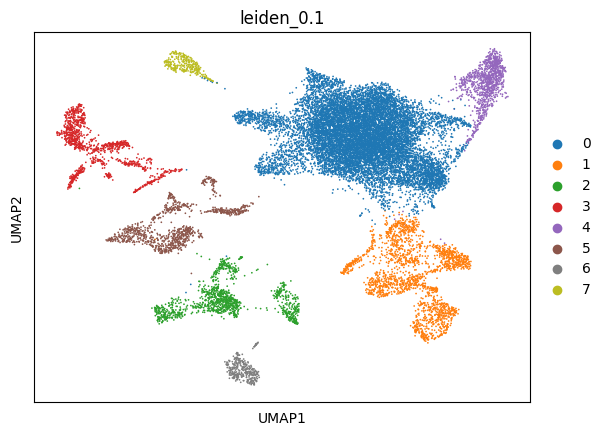

In [264]:
sc.pl.umap(adata, color=['leiden_0.1'])

Filtered UMAP

### 6. Marker Genes and DEG

Wilcoxon method will be used to detect marker genes in the clusters, the same method will be used to calculate differentially expressed genes per cluster. A list of genes will be ranked and saved as a tsv file.

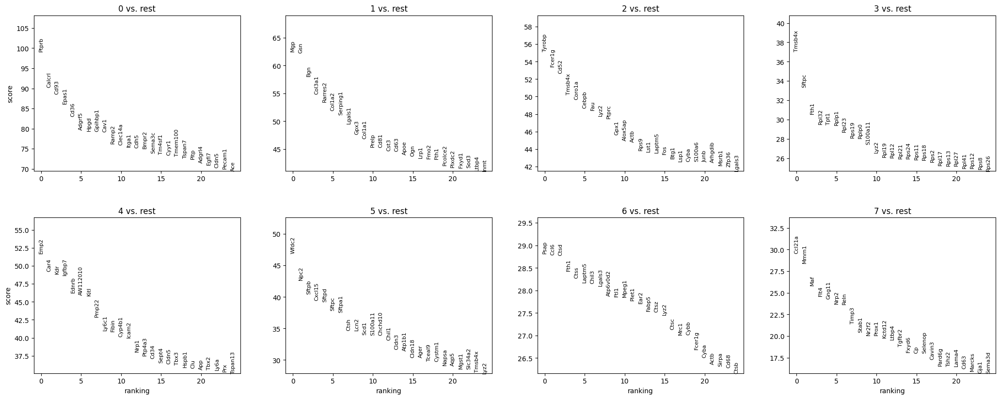

In [265]:
sc.tl.rank_genes_groups(adata, 'leiden_0.1', method='wilcoxon', use_raw=True, key_added='rank_leiden_0.1')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key='rank_leiden_0.1')

In [266]:
df_ranked_genes = sc.get.rank_genes_groups_df(adata, '0', key='rank_leiden_0.1')
df_ranked_genes

,names,scores,logfoldchanges,pvals,pvals_adj
0,Ptprb,99.242546,5.039284,0.0,0.0
1,Calcrl,90.337296,4.166283,0.0,0.0
2,Cd93,88.617119,4.573915,0.0,0.0
3,Epas1,86.139992,3.454720,0.0,0.0
4,Cd36,83.060677,3.574442,0.0,0.0
...,...,...,...,...,...
16905,Cd63,-47.473278,-3.990132,0.0,0.0
16906,S100a6,-51.561855,-3.915893,0.0,0.0
16907,S100a11,-57.016960,-2.640301,0.0,0.0
16908,Ftl1,-57.310963,-1.879516,0.0,0.0


In [267]:
import os
outdir = "/mnt/storage/" + os.environ['USER'] + "/jupyternotebooks/scRNA_seq_assign"

In [268]:
outf = outdir + "/marker_cluster0_rank_leiden_0.1.tsv"
df_ranked_genes.to_csv(outf, sep="\t", index=None)
print(outf)

/mnt/storage/r0870275/jupyternotebooks/scRNA_seq_assign/marker_cluster0_rank_leiden_0.1.tsv


Now, we can see the 3 top marker genes. We see that some genes like Calcrl are expressed in more than one clusters.To   be sure that these genes are really markers we can filter more striclty.

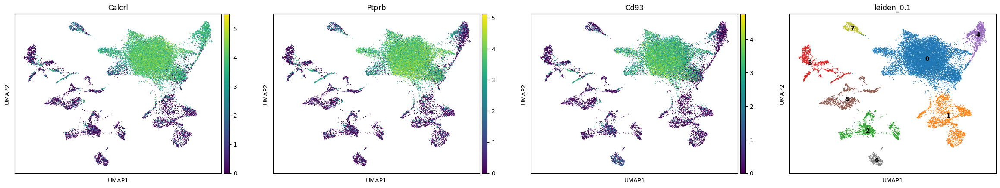

In [269]:
sc.pl.umap(adata, color=['Calcrl', 'Ptprb','Cd93', 'leiden_0.1'], legend_loc='on data')

Filterng more: Here min_in_group_fraction specifies a threshold for the fraction of cells that express the marker in the cluster and max_out_group_fraction outside of the clusters. We can also set an additional threshold for the log-fold change here min_fold_change. For example, if we set max_out_group_fraction=0.5

In [272]:
# sparsity
sc.tl.filter_rank_genes_groups(
    adata,
    min_in_group_fraction=0.25,
    max_out_group_fraction=0.5,
    min_fold_change=2,
    key="rank_leiden_0.1",
    key_added="rank_leiden_0.1_filtered",
)

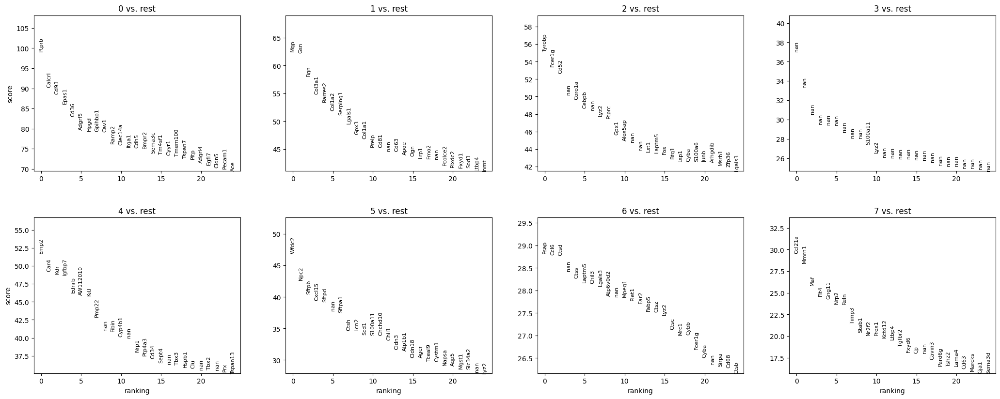

In [273]:
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key='rank_leiden_0.1_filtered')

#### Gprofiler

We can query gprofiler to gain insight about the genes in each of the cluster.

In [274]:
df_rank_cur_cluster = sc.get.rank_genes_groups_df(adata, '0', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
sel_genes = [ gene for gene in df_rank_cur_cluster.dropna()['names'] ]
sc.queries.enrich( sel_genes, org='mmusculus').head(n=10)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0001944,vasculature development,1.342736e-31,True,"""The process whose specific outcome is the pro...",787,114,42,26856,0.368421,0.053367,query_1,"[GO:0048731, GO:0072359]"
1,GO:BP,GO:0001568,blood vessel development,1.091067e-29,True,"""The process whose specific outcome is the pro...",756,114,40,26856,0.350877,0.052910,query_1,"[GO:0001944, GO:0048856]"
2,GO:BP,GO:0048514,blood vessel morphogenesis,1.837790e-29,True,"""The process in which the anatomical structure...",654,114,38,26856,0.333333,0.058104,query_1,"[GO:0001568, GO:0035239]"
3,GO:BP,GO:0072359,circulatory system development,1.751788e-27,True,"""The process whose specific outcome is the pro...",1210,114,45,26856,0.394737,0.037190,query_1,[GO:0048731]
4,GO:BP,GO:0035295,tube development,8.116138e-27,True,"""The process whose specific outcome is the pro...",1178,114,44,26856,0.385965,0.037351,query_1,"[GO:0007275, GO:0048856]"
5,GO:BP,GO:0035239,tube morphogenesis,2.652681e-26,True,"""The process in which the anatomical structure...",925,114,40,26856,0.350877,0.043243,query_1,"[GO:0009653, GO:0035295]"
6,GO:BP,GO:0001525,angiogenesis,2.817329e-25,True,"""Blood vessel formation when new vessels emerg...",557,114,33,26856,0.289474,0.059246,query_1,"[GO:0048514, GO:0048646]"
7,GO:BP,GO:0009653,anatomical structure morphogenesis,3.803654e-24,True,"""The process in which anatomical structures ar...",2773,114,58,26856,0.508772,0.020916,query_1,"[GO:0032502, GO:0048856]"
8,GO:BP,GO:0016477,cell migration,3.513095e-21,True,"""The controlled self-propelled movement of a c...",1525,114,43,26856,0.377193,0.028197,query_1,[GO:0048870]
9,GO:BP,GO:0048646,anatomical structure formation involved in mor...,8.681140e-21,True,"""The developmental process pertaining to the i...",1213,114,39,26856,0.342105,0.032152,query_1,"[GO:0009653, GO:0032502]"


For example, for cluster 0 the genes are involved in processes like vasculature, blood vessel, circulatory and tube development, this is in general referring to angiogenesis, which is the physiological process involving the formation of new blood vessels from existing ones. Angiogenesis plays a crucial role in various biological processes, including tissue growth, wound healing, and reproduction. It's particularly important in diseases such as cancer, where tumors require a blood supply for growth and metastasis. This makes sense given that some of our cells come from lung tumor cells.

In [275]:
df_rank_cur_cluster = sc.get.rank_genes_groups_df(adata, '1', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
sel_genes = [ gene for gene in df_rank_cur_cluster.dropna()['names'] ]
sc.queries.enrich( sel_genes, org='mmusculus').head(n=10)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0031012,extracellular matrix,7.259538e-62,True,"""A structure lying external to one or more cel...",497,199,66,26959,0.331658,0.132797,query_1,[GO:0030312]
1,GO:CC,GO:0030312,external encapsulating structure,9.549030e-62,True,"""A structure that lies outside the plasma memb...",499,199,66,26959,0.331658,0.132265,query_1,"[GO:0071944, GO:0110165]"
2,GO:CC,GO:0062023,collagen-containing extracellular matrix,2.103986e-58,True,"""An extracellular matrix consisting mainly of ...",365,199,58,26959,0.291457,0.158904,query_1,[GO:0031012]
3,GO:CC,GO:0005576,extracellular region,3.987318e-49,True,"""The space external to the outermost structure...",2534,199,102,26959,0.512563,0.040253,query_1,[GO:0110165]
4,GO:MF,GO:0005201,extracellular matrix structural constituent,4.143680e-43,True,"""The action of a molecule that contributes to ...",132,193,36,24945,0.186528,0.272727,query_1,[GO:0005198]
5,GO:CC,GO:0005615,extracellular space,6.399967e-42,True,"""That part of a multicellular organism outside...",1826,199,83,26959,0.417085,0.045455,query_1,"[GO:0005576, GO:0110165]"
6,GO:BP,GO:0048856,anatomical structure development,8.421018e-36,True,"""The biological process whose specific outcome...",6222,193,130,26856,0.673575,0.020894,query_1,[GO:0032502]
7,GO:BP,GO:0032502,developmental process,4.738630e-33,True,"""A biological process whose specific outcome i...",6808,193,132,26856,0.683938,0.019389,query_1,[GO:0008150]
8,GO:BP,GO:0048731,system development,4.744348e-31,True,"""The process whose specific outcome is the pro...",4076,193,102,26856,0.528497,0.025025,query_1,"[GO:0007275, GO:0048856]"
9,GO:BP,GO:0009888,tissue development,3.538568e-30,True,"""The process whose specific outcome is the pro...",2105,193,75,26856,0.388601,0.035629,query_1,[GO:0048856]


Cluster 1 is related to the extracellular matrix and tissue developmet. The extracellular matrix is a complex network of molecules that provides structural and biochemical support to surrounding cells and tissues. It plays a critical role in various biological processes, including tissue development, maintenance, and signaling.

In [276]:
df_rank_cur_cluster0 = sc.get.rank_genes_groups_df(adata, '0', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
outf = outdir + "/marker_cluster0_rank_leiden_0.1.tsv"
df_rank_cur_cluster0.to_csv(outf, sep="\t", index=None)

df_rank_cur_cluster1 = sc.get.rank_genes_groups_df(adata, '1', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
outf = outdir + "/marker_cluster1_rank_leiden_0.1.tsv"
df_rank_cur_cluster0.to_csv(outf, sep="\t", index=None)

df_rank_cur_cluster2 = sc.get.rank_genes_groups_df(adata, '2', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
outf = outdir + "/marker_cluster2_rank_leiden_0.1.tsv"
df_rank_cur_cluster0.to_csv(outf, sep="\t", index=None)

df_rank_cur_cluster3 = sc.get.rank_genes_groups_df(adata, '3', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
outf = outdir + "/marker_cluster3_rank_leiden_0.1.tsv"
df_rank_cur_cluster0.to_csv(outf, sep="\t", index=None)

df_rank_cur_cluster4 = sc.get.rank_genes_groups_df(adata, '4', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
outf = outdir + "/marker_cluster4_rank_leiden_0.1.tsv"
df_rank_cur_cluster4.to_csv(outf, sep="\t", index=None)

df_rank_cur_cluster5 = sc.get.rank_genes_groups_df(adata, '5', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
outf = outdir + "/marker_cluster5_rank_leiden_0.1.tsv"
df_rank_cur_cluster5.to_csv(outf, sep="\t", index=None)

df_rank_cur_cluster6 = sc.get.rank_genes_groups_df(adata, '6', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
outf = outdir + "/marker_cluster6_rank_leiden_0.1.tsv"
df_rank_cur_cluster0.to_csv(outf, sep="\t", index=None)

df_rank_cur_cluster7 = sc.get.rank_genes_groups_df(adata, '7', key='rank_leiden_0.1_filtered', 
                                                  log2fc_min=2, pval_cutoff=0.05)
outf = outdir + "/marker_cluster7_rank_leiden_0.1.tsv"
df_rank_cur_cluster7.to_csv(outf, sep="\t", index=None)

All the ranked filtered market genes per cluster were saved as tsv files.

### 6.1 Annotating cell types

The cell annotations for this data were found in the literature, from the study were the data comes from [1]. In this way, Cell types were inferred based on expression of canonical marker genes found in the table bellow.

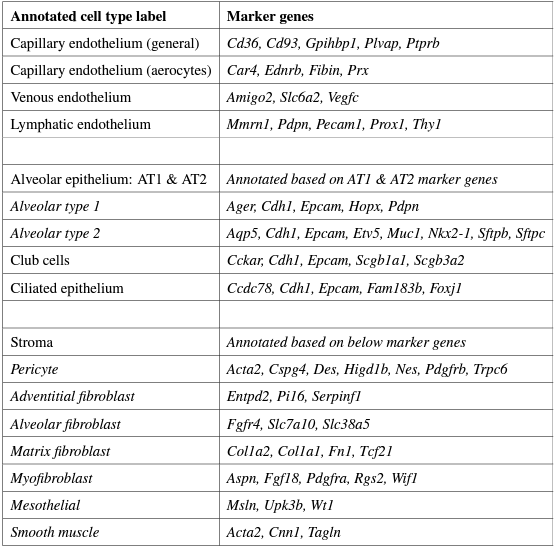

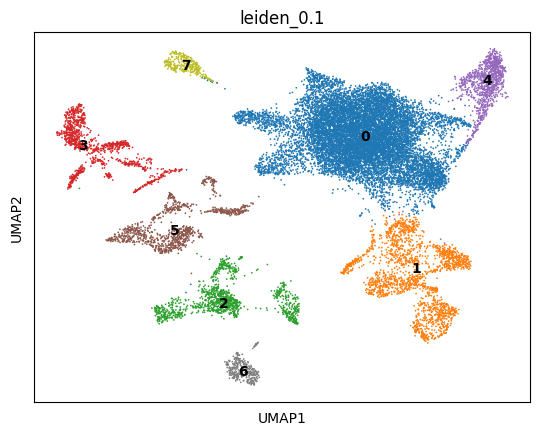

In [277]:
sc.pl.umap(adata, color=['leiden_0.1'], cmap='inferno', legend_loc='on data')

#### Cluster 0: Capillary endothelium(general)

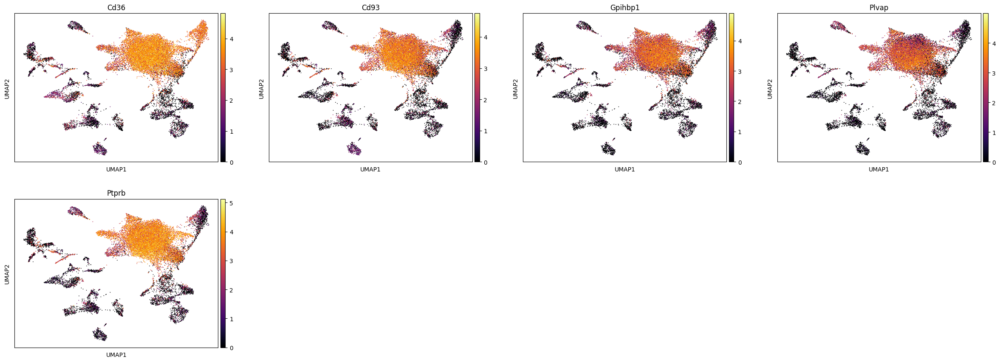

In [278]:
sc.pl.umap(adata, color=['Cd36','Cd93','Gpihbp1','Plvap','Ptprb'], cmap='inferno', legend_loc='on data')

#### Cluster 4: Capillaryendothelium(aerocytes)

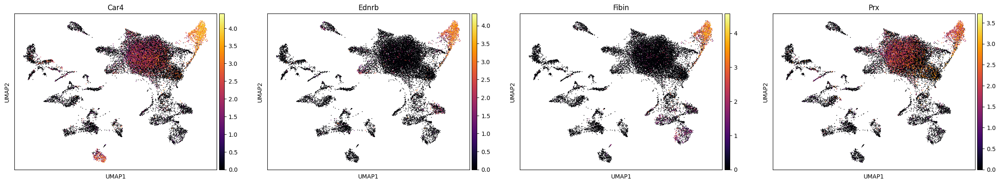

In [279]:
sc.pl.umap(adata, color=['Car4','Ednrb','Fibin','Prx'], cmap='inferno', legend_loc='on data')

#### Cluster 7: Lymphatic endothelium

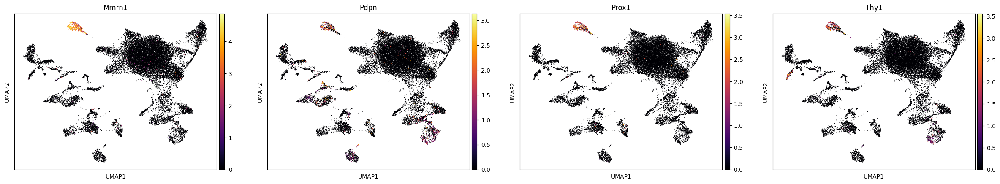

In [280]:
sc.pl.umap(adata, color=['Mmrn1','Pdpn','Prox1','Thy1'], cmap='inferno', legend_loc='on data')

#### Cluster 5: Alveolar type 1 and 2

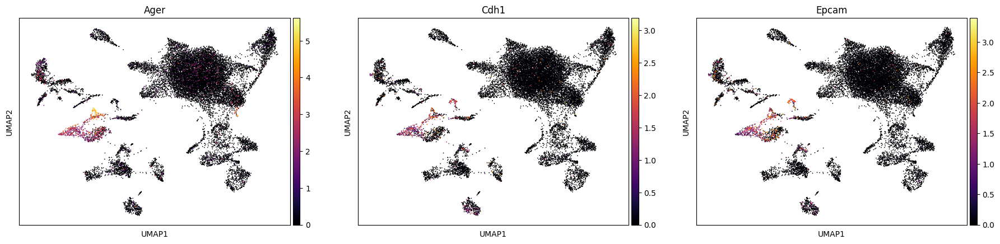

In [281]:
sc.pl.umap(adata, color=['Ager','Cdh1','Epcam'], cmap='inferno', legend_loc='on data')

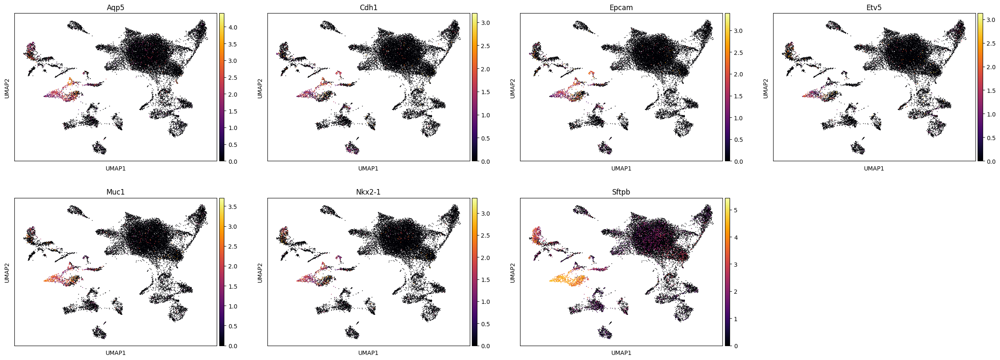

In [282]:
sc.pl.umap(adata, color=['Aqp5','Cdh1','Epcam','Etv5','Muc1','Nkx2-1','Sftpb'], cmap='inferno', legend_loc='on data')

#### Cluster 1: Stroma (fibroblasts, SMCs, pericytes)

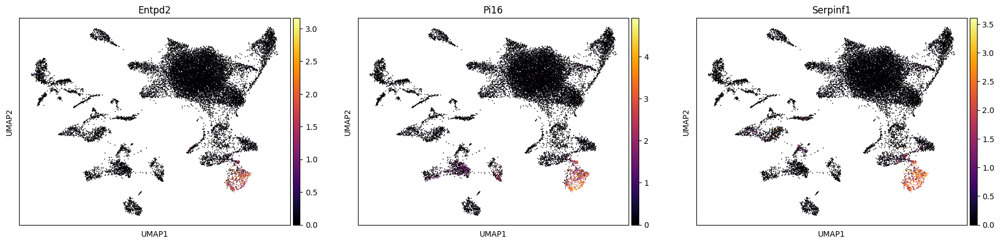

In [284]:
sc.pl.umap(adata, color=['Entpd2','Pi16','Serpinf1'], cmap='inferno', legend_loc='on data')

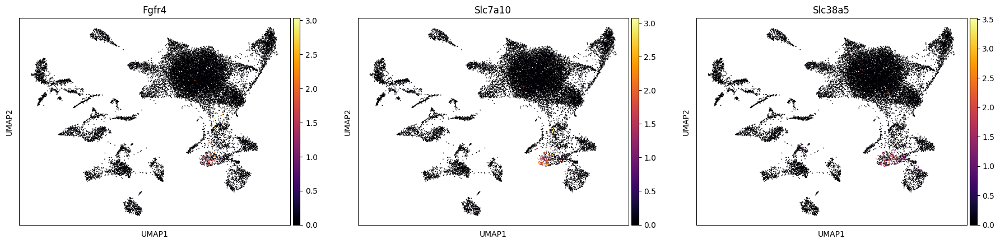

In [285]:
sc.pl.umap(adata, color=['Fgfr4','Slc7a10','Slc38a5'], cmap='inferno', legend_loc='on data')

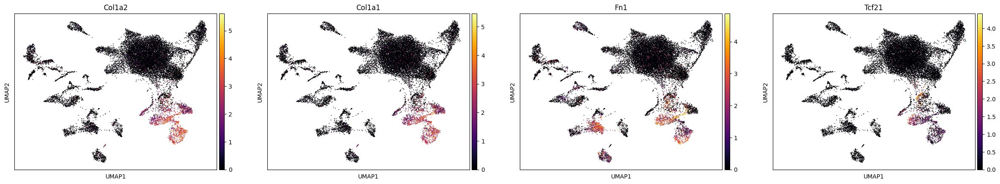

In [286]:
sc.pl.umap(adata, color=['Col1a2','Col1a1','Fn1','Tcf21'], cmap='inferno', legend_loc='on data')

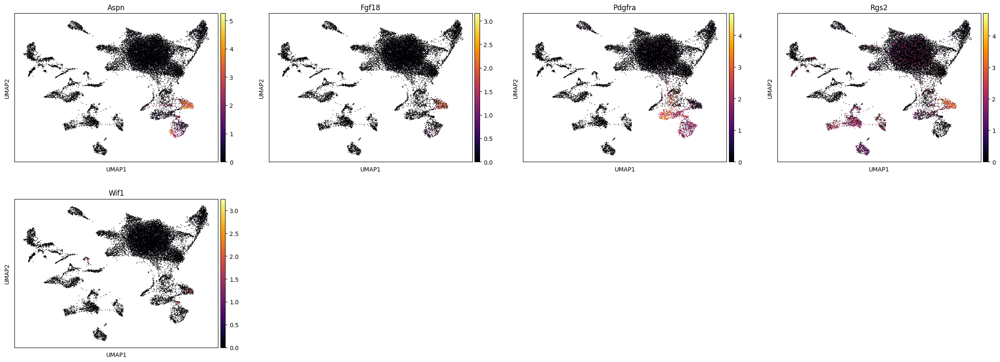

In [291]:
sc.pl.umap(adata,color=['Aspn','Fgf18','Pdgfra','Rgs2','Wif1'], cmap='inferno', legend_loc='on data')

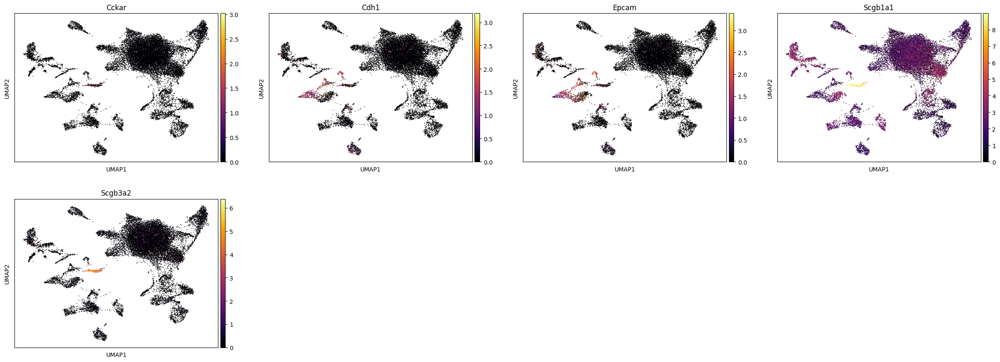

In [289]:
sc.pl.umap(adata ,color=['Cckar','Cdh1','Epcam','Scgb1a1','Scgb3a2'], cmap='inferno', legend_loc='on data')

In [296]:
dict_annotate_clusters = {
    '0': 'Capillary endothelium(general)',
    '4': 'Capillaryendothelium(aerocytes)',
    '1': 'Stroma',
    '5': 'AT1 & AT2',
    '7' :  'Lymphatic endothelium'
}

In [297]:
adata.obs['celltype'] = [ dict_annotate_clusters[cluster] if cluster in dict_annotate_clusters.keys()
                        else 'unknown_cluster' + cluster
                        for cluster in adata.obs['leiden_0.1'] ]

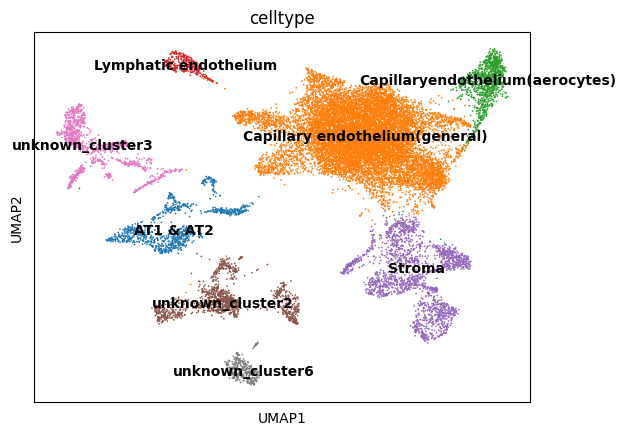

In [298]:
sc.pl.umap(adata, color=['celltype'], legend_loc='on data')

In total 3 clusters were not annotated, this can be due to several reason like the presence of mixed cell populations or technical variability and noise. Althought, this is not ideal, the main cell types for this study were able to be annotated.

### 7. DEG per sample and Functional Analysis Cluster 0

Untill now, all the analysis was done using the integrated data set. Now we are goint to compare the DEGs between the WT sample and the EA mutant sample, specifically for cluster 0, that correspond to the capillary endothelium cells.

When we plot the cluster 0 per sample we can see clearly that Endothelial cells from Eml4-Alk and healthy lungs exhibited differential transcriptional landscapes.

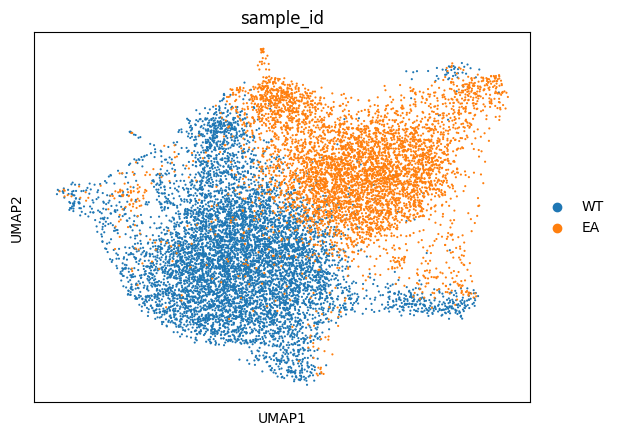

In [350]:
cluster_0 = adata[adata.obs['leiden_0.1'] == '0']

# Create UMAP plot and color by 'sampleid'
sc.pp.neighbors(cluster_0)
sc.tl.umap(cluster_0)
sc.pl.umap(cluster_0, color='sample_id')

#### Computing DEG for the EA sample and gProfiler of the resulting upregulated genes

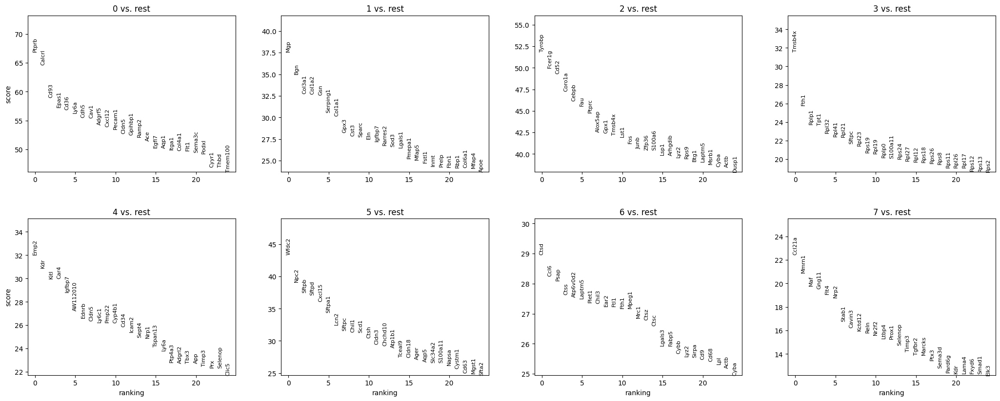

In [341]:
# Assuming 'sample_id' is the column in adata.obs indicating the sample ID

# Filter the integrated data for a specific sample
sample_of_interest = 'EA'  # Replace with your sample ID
adata_sampleEA = adata[adata.obs['sample_id'] == sample_of_interest].copy()

# Perform differential expression analysis for the specific sample
sc.tl.rank_genes_groups(adata_sampleEA, 'leiden_0.1', method='wilcoxon', use_raw=True, key_added='rank_leiden_0.1_EA')

# Visualize DEGs for the specific sample
sc.pl.rank_genes_groups(adata_sampleEA, n_genes=25, sharey=False, key='rank_leiden_0.1_EA')

df_rank_cur_clusterEA = sc.get.rank_genes_groups_df(adata_sampleEA, '0', key='rank_leiden_0.1_EA', 
                                                  log2fc_min=1, pval_cutoff=0.05)
df_rank_cur_clusterEA['names']

outf = outdir + "/upgenes_cluster0EA_rank_leiden_0.1.tsv"
df_rank_cur_clusterEA['names'].to_csv(outf, sep="\t", index=None)

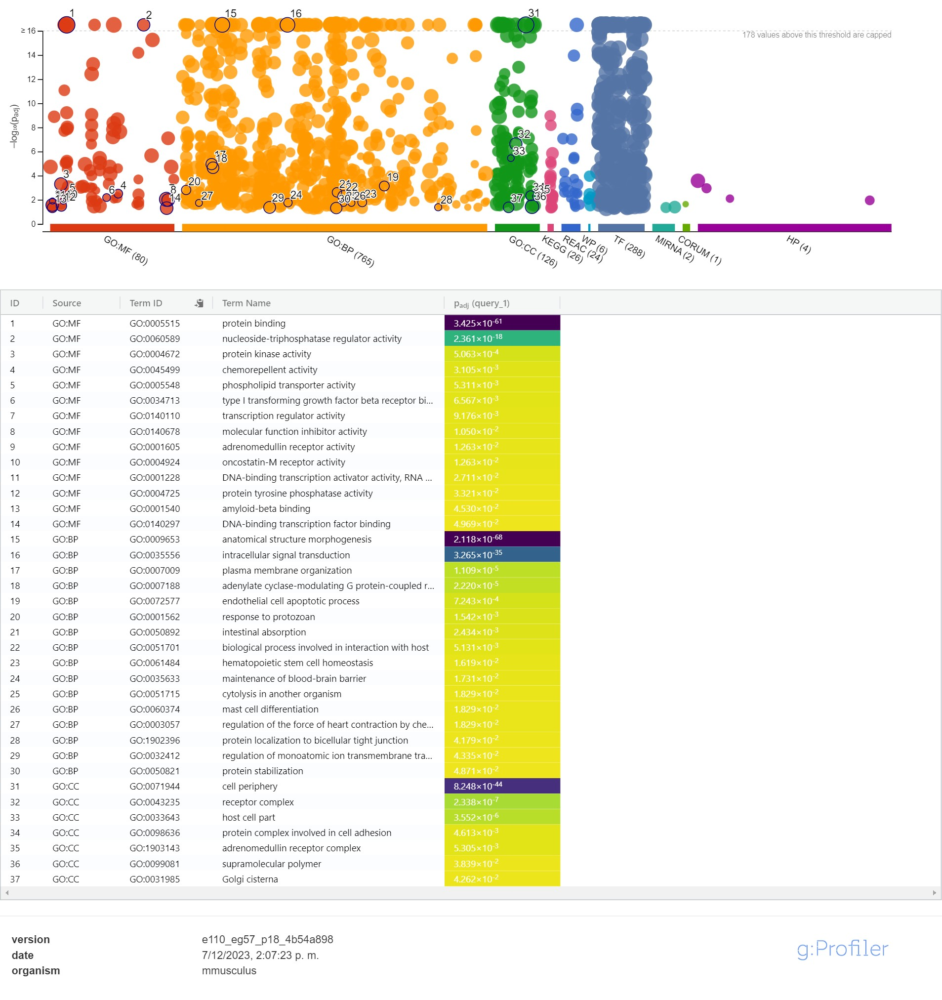

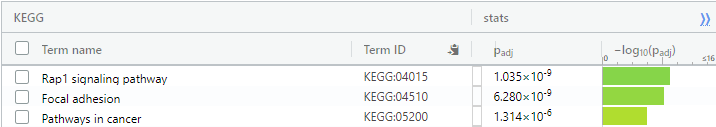

Some of the significatn enriched GO terms for EA cells in cluster 0 are Anatolical structure morphogenesis, vasculature development and blood vesses development. Furthermore some KEGG pathways found were the Rap1 signaling pathway, focal adhesion and pathways in cancer. 

In [342]:
sel_genes = [ gene for gene in df_rank_cur_clusterEA.dropna()['names'] ]
sc.queries.enrich( sel_genes, org='mmusculus').head(n=10)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0009653,anatomical structure morphogenesis,2.046551e-68,True,"""The process in which anatomical structures ar...",2773,695,245,26856,0.352518,0.088352,query_1,"[GO:0032502, GO:0048856]"
1,GO:BP,GO:0001944,vasculature development,1.787847e-62,True,"""The process whose specific outcome is the pro...",787,695,129,26856,0.185612,0.163914,query_1,"[GO:0048731, GO:0072359]"
2,GO:BP,GO:0001568,blood vessel development,9.305182e-62,True,"""The process whose specific outcome is the pro...",756,695,126,26856,0.181295,0.166667,query_1,"[GO:0001944, GO:0048856]"
3,GO:MF,GO:0005515,protein binding,4.234806e-61,True,"""Binding to a protein."" [GOC:go_curators]",10378,692,504,24945,0.728324,0.048564,query_1,[GO:0005488]
4,GO:BP,GO:0035239,tube morphogenesis,3.987340e-60,True,"""The process in which the anatomical structure...",925,695,136,26856,0.195683,0.147027,query_1,"[GO:0009653, GO:0035295]"
5,GO:BP,GO:0007275,multicellular organism development,1.085020e-59,True,"""The biological process whose specific outcome...",4828,695,314,26856,0.451799,0.065037,query_1,"[GO:0032501, GO:0048856]"
6,GO:BP,GO:0048514,blood vessel morphogenesis,1.878026e-59,True,"""The process in which the anatomical structure...",654,695,116,26856,0.166906,0.177370,query_1,"[GO:0001568, GO:0035239]"
7,GO:BP,GO:0048731,system development,1.629359e-58,True,"""The process whose specific outcome is the pro...",4076,695,284,26856,0.408633,0.069676,query_1,"[GO:0007275, GO:0048856]"
8,GO:BP,GO:0016477,cell migration,5.343527e-57,True,"""The controlled self-propelled movement of a c...",1525,695,168,26856,0.241727,0.110164,query_1,[GO:0048870]
9,GO:BP,GO:0072359,circulatory system development,7.564414e-57,True,"""The process whose specific outcome is the pro...",1210,695,150,26856,0.215827,0.123967,query_1,[GO:0048731]


#### Computing DEG for the WT sample and gProfiler of the resulting upregulated genes

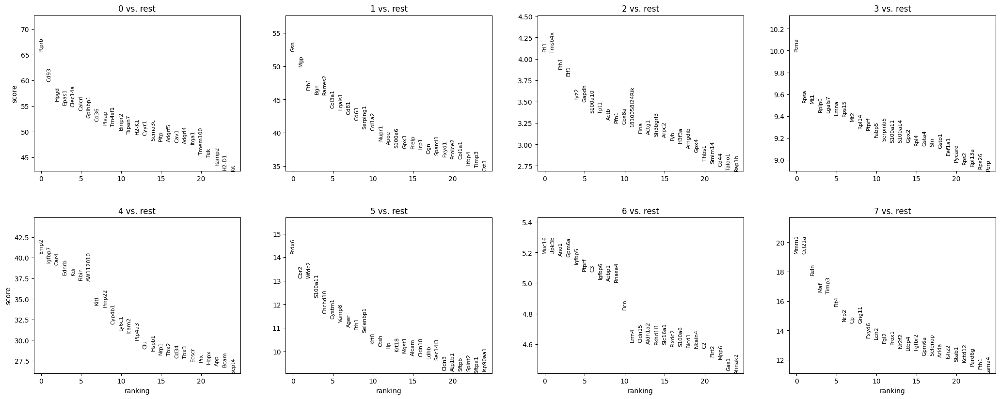

In [353]:
# Assuming 'sample_id' is the column in adata.obs indicating the sample ID

# Filter the integrated data for a specific sample
sample_of_interest = 'WT'  # Replace with your sample ID
adata_sampleWT = adata[adata.obs['sample_id'] == sample_of_interest].copy()

# Perform differential expression analysis for the specific sample
sc.tl.rank_genes_groups(adata_sampleWT, 'leiden_0.1', method='wilcoxon', use_raw=True, key_added='rank_leiden_0.1_WT')

# Visualize DEGs for the specific sample
sc.pl.rank_genes_groups(adata_sampleWT, n_genes=25, sharey=False, key='rank_leiden_0.1_WT')

df_rank_cur_clusterWT = sc.get.rank_genes_groups_df(adata_sampleWT, '0', key='rank_leiden_0.1_WT', 
                                                  log2fc_min=1, pval_cutoff=0.05)
df_rank_cur_clusterWT['names']

outf = outdir + "/upgenes_cluster0WT_rank_leiden_0.1.tsv"
df_rank_cur_clusterWT['names'].to_csv(outf, sep="\t", index=None)

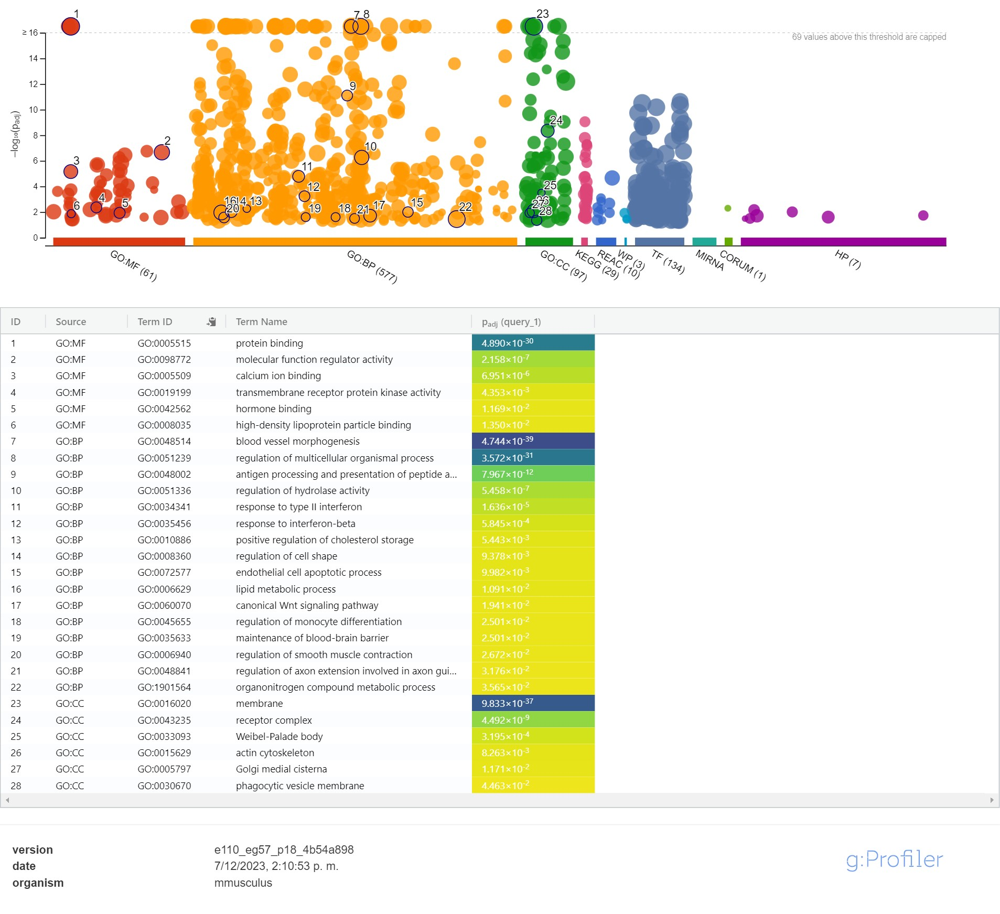

For the WT cells some of the DEGs were associated with calcium ion binding, transmembrane receptor protein kinase and other terms also identified in the EA cells. 

In [354]:
sel_genes = [ gene for gene in df_rank_cur_clusterWT.dropna()['names'] ]
sc.queries.enrich( sel_genes, org='mmusculus').head(n=10)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0048514,blood vessel morphogenesis,2.984566e-39,True,"""The process in which the anatomical structure...",654,432,76,26856,0.175926,0.116208,query_1,"[GO:0001568, GO:0035239]"
1,GO:BP,GO:0001944,vasculature development,4.705429e-39,True,"""The process whose specific outcome is the pro...",787,432,82,26856,0.189815,0.104193,query_1,"[GO:0048731, GO:0072359]"
2,GO:BP,GO:0001568,blood vessel development,1.715641e-38,True,"""The process whose specific outcome is the pro...",756,432,80,26856,0.185185,0.105820,query_1,"[GO:0001944, GO:0048856]"
3,GO:BP,GO:0035239,tube morphogenesis,2.776501e-37,True,"""The process in which the anatomical structure...",925,432,86,26856,0.199074,0.092973,query_1,"[GO:0009653, GO:0035295]"
4,GO:BP,GO:0001525,angiogenesis,4.305097e-37,True,"""Blood vessel formation when new vessels emerg...",557,432,69,26856,0.159722,0.123878,query_1,"[GO:0048514, GO:0048646]"
5,GO:CC,GO:0016020,membrane,1.615303e-36,True,"""A lipid bilayer along with all the proteins a...",10306,441,303,26959,0.687075,0.029400,query_1,[GO:0110165]
6,GO:BP,GO:0048646,anatomical structure formation involved in mor...,8.413970e-34,True,"""The developmental process pertaining to the i...",1213,432,93,26856,0.215278,0.076669,query_1,"[GO:0009653, GO:0032502]"
7,GO:BP,GO:0035295,tube development,3.161013e-33,True,"""The process whose specific outcome is the pro...",1178,432,91,26856,0.210648,0.077250,query_1,"[GO:0007275, GO:0048856]"
8,GO:BP,GO:0009653,anatomical structure morphogenesis,4.200547e-33,True,"""The process in which anatomical structures ar...",2773,432,140,26856,0.324074,0.050487,query_1,"[GO:0032502, GO:0048856]"
9,GO:BP,GO:0072359,circulatory system development,2.616676e-32,True,"""The process whose specific outcome is the pro...",1210,432,91,26856,0.210648,0.075207,query_1,[GO:0048731]


In [348]:
# upragulated genes
df_rank_cur_cluster = sc.get.rank_genes_groups_df(adata, '0', key='rank_leiden_0.1', 
                                                  log2fc_min=1, pval_cutoff=0.05)
df_rank_cur_cluster['names']
outf = outdir + "/upgenes_cluster0_rank_leiden_0.1.tsv"
df_rank_cur_cluster['names'].to_csv(outf, sep="\t", index=None)

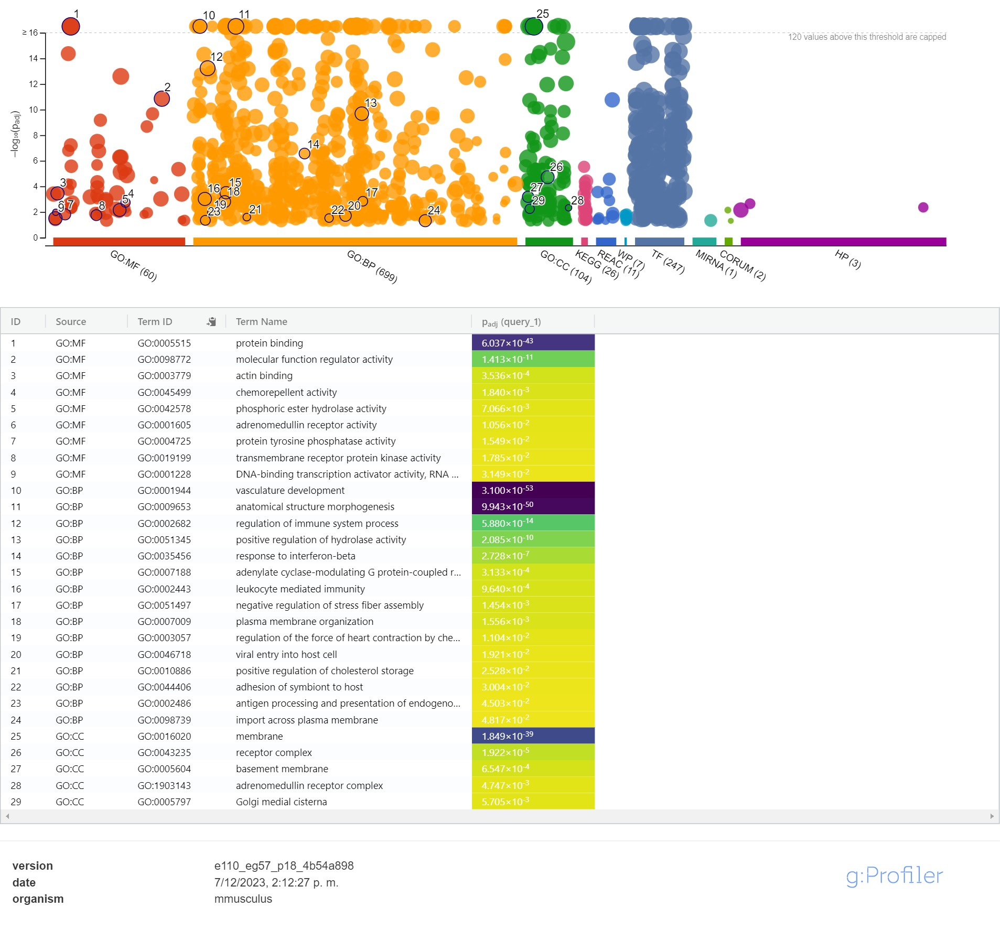

In [347]:
sel_genes = [ gene for gene in df_rank_cur_cluster.dropna()['names'] ]
sc.queries.enrich( sel_genes, org='mmusculus').head(n=10)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0001944,vasculature development,1.093291e-53,True,"""The process whose specific outcome is the pro...",787,627,114,26856,0.181818,0.144854,query_1,"[GO:0048731, GO:0072359]"
1,GO:BP,GO:0035239,tube morphogenesis,3.278238e-53,True,"""The process in which the anatomical structure...",925,627,122,26856,0.194577,0.131892,query_1,"[GO:0009653, GO:0035295]"
2,GO:BP,GO:0001568,blood vessel development,9.443955e-53,True,"""The process whose specific outcome is the pro...",756,627,111,26856,0.177033,0.146825,query_1,"[GO:0001944, GO:0048856]"
3,GO:BP,GO:0048514,blood vessel morphogenesis,1.504479e-52,True,"""The process in which the anatomical structure...",654,627,104,26856,0.165869,0.159021,query_1,"[GO:0001568, GO:0035239]"
4,GO:BP,GO:0009653,anatomical structure morphogenesis,7.765270e-50,True,"""The process in which anatomical structures ar...",2773,627,204,26856,0.325359,0.073567,query_1,"[GO:0032502, GO:0048856]"
5,GO:BP,GO:0001525,angiogenesis,2.061533e-49,True,"""Blood vessel formation when new vessels emerg...",557,627,94,26856,0.149920,0.168761,query_1,"[GO:0048514, GO:0048646]"
6,GO:BP,GO:0072359,circulatory system development,3.036063e-48,True,"""The process whose specific outcome is the pro...",1210,627,132,26856,0.210526,0.109091,query_1,[GO:0048731]
7,GO:BP,GO:0035295,tube development,5.401510e-48,True,"""The process whose specific outcome is the pro...",1178,627,130,26856,0.207337,0.110357,query_1,"[GO:0007275, GO:0048856]"
8,GO:BP,GO:0007275,multicellular organism development,6.634807e-46,True,"""The biological process whose specific outcome...",4828,627,270,26856,0.430622,0.055924,query_1,"[GO:0032501, GO:0048856]"
9,GO:BP,GO:0048731,system development,1.046782e-44,True,"""The process whose specific outcome is the pro...",4076,627,243,26856,0.387560,0.059617,query_1,"[GO:0007275, GO:0048856]"


For the integrated dataset some GO terms significant were also vasculature development, tube morphogenesis and blood vessels development.

### Conclusions

From the integrated scRNA-seq analysis comparing healthy lung cells to Eml4-Alk mutant lung cells, several key findings emerge from the clustering and differential gene expression analyses, particularly related to cell annotations and enriched biological processes:

**Cellular Composition and Annotations:**
The clustering analysis identified seven distinct cell clusters, each representing specific cell types or subtypes within the lung tissue:

- Capillary Endothelium (General) and Capillary Endothelium (Aerocyte):

Identified two subsets of capillary endothelial cells, suggesting potential heterogeneity within endothelial populations, possibly associated with functional specialization or response to the Eml4-Alk mutation [1].

- Alveolar Epithelium (AT1 + AT2):

Recognition of alveolar epithelial cells, including AT1 and AT2 subtypes, crucial for gas exchange, and ciliated epithelium involved in airway maintenance, indicating representation of key lung cell types [1].

- Stroma (Fibroblasts, SMCs, Pericytes):

Presence of stromal cell types (fibroblasts, smooth muscle cells, pericytes), suggesting their involvement in lung tissue structure, regulation, and potential alterations in the mutant condition [1].

- Lymphatic Endothelium:

Distinct identification of endothelial subtypes (lymphatic) and club cells, hinting at differences in vascular specialization and specific epithelial cell functions between healthy and mutant conditions [1].


**Enriched Biological Processes:**

The analysis of differentially expressed genes (DEGs) and gene ontology (GO) terms enrichment highlighted significant associations with processes related to vasculature development, tube morphogenesis, and blood vessel development.

The enrichment of these GO terms indicates that genes differentially expressed between healthy and Eml4-Alk mutant lung cells are significantly involved in regulating the formation, shaping, and development of blood vessels and related structures.


The scRNA-seq analysis revealed alterations in cellular composition, suggesting potential changes in endothelial subtypes, epithelial cells, and stromal components between healthy and Eml4-Alk mutant lung tissues. The enrichment of GO terms related to vascular development signifies a potential impact of the Eml4-Alk mutation on processes crucial for blood vessel formation and tube morphogenesis within the lung.

This comprehensive characterization points towards potential shifts in cellular populations and biological processes associated with lung tissue function and development affected by the Eml4-Alk mutation. Further investigation into the identified cell types, specific gene expression profiles, and functional validations would deepen our understanding of the molecular mechanisms underlying the mutation's effects on lung biology and disease progression.

### References

[1] Amini, A.P., Kirkpatrick, J.D., Wang, C.S. et al. Multiscale profiling of protease activity in cancer. Nat Commun 13, 5745 (2022). https://doi.org/10.1038/s41467-022-32988-5